In [ ]:
import re
import numpy as np
import pandas as pd
import datetime as dt
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [ ]:
!pip install --upgrade ydata-profiling

In [ ]:
import ydata_profiling as yp

In [ ]:
#import pandas as pd
from ydata_profiling import ProfileReport

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving Plane_Price.csv to Plane_Price.csv


In [ ]:
df = pd.read_csv('Plane_Price.csv')
profile = ProfileReport(df, title="Profiling Report")

In [ ]:
from IPython.display import display

In [ ]:
# Use the following line to display the report in the notebook
display(profile)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df.head()

,Model Name,Engine Type,HP or lbs thr ea engine,Max speed Knots,Rcmnd cruise Knots,Stall Knots dirty,Fuel gal/lbs,All eng rate of climb,Eng out rate of climb,Takeoff over 50ft,Landing over 50ft,Empty weight lbs,Length ft/in,Wing span ft/in,Range N.M.,Price
0,100 Darter (S.L. Industries),Piston,145,104,91.0,46.0,36,450,900.0,1300.0,"2,050","1,180",25/3,37/5,370,1300000.0
1,7 CCM Champ,Piston,85,89,83.0,44.0,15,600,720.0,800.0,"1,350",820,20/7,36/1,190,1230000.0
2,100 Darter (S.L. Industries),Piston,90,90,78.0,37.0,19,650,475.0,850.0,"1,300",810,21/5,35/0,210,1600000.0
3,7 AC Champ,Piston,85,88,78.0,37.0,19,620,500.0,850.0,"1,300",800,21/5,35/0,210,1300000.0
4,100 Darter (S.L. Industries),Piston,65,83,74.0,33.0,14,370,632.0,885.0,"1,220",740,21/5,35/0,175,1250000.0


In [ ]:
df.describe()

,Rcmnd cruise Knots,Stall Knots dirty,Fuel gal/lbs,Eng out rate of climb,Takeoff over 50ft,Price
count,507.000000,502.000000,517.000000,491.000000,492.000000,5.070000e+02
mean,200.792899,60.795817,1419.379110,2065.126273,1743.306911,2.362673e+06
std,104.280532,16.657002,4278.320773,1150.031899,730.009674,1.018731e+06
min,70.000000,27.000000,12.000000,457.000000,500.000000,6.500000e+05
25%,130.000000,50.000000,50.000000,1350.000000,1265.000000,1.600000e+06
50%,169.000000,56.000000,89.000000,1706.000000,1525.000000,2.000000e+06
75%,232.000000,73.000000,335.000000,2357.000000,2145.750000,2.950000e+06
max,511.000000,115.000000,41000.000000,6400.000000,4850.000000,5.100000e+06


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 517 entries, 0 to 516
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Model Name               517 non-null    object 
 1   Engine Type              517 non-null    object 
 2   HP or lbs thr ea engine  517 non-null    object 
 3   Max speed Knots          497 non-null    object 
 4   Rcmnd cruise Knots       507 non-null    float64
 5   Stall Knots dirty        502 non-null    float64
 6   Fuel gal/lbs             517 non-null    int64  
 7   All eng rate of climb    513 non-null    object 
 8   Eng out rate of climb    491 non-null    float64
 9   Takeoff over 50ft        492 non-null    float64
 10  Landing over 50ft        517 non-null    object 
 11  Empty weight lbs         516 non-null    object 
 12  Length ft/in             517 non-null    object 
 13  Wing span ft/in          517 non-null    object 
 14  Range N.M.               4

In [ ]:
df.isna().sum()

Model Name                  0
Engine Type                 0
HP or lbs thr ea engine     0
Max speed Knots            20
Rcmnd cruise Knots         10
Stall Knots dirty          15
Fuel gal/lbs                0
All eng rate of climb       4
Eng out rate of climb      26
Takeoff over 50ft          25
Landing over 50ft           0
Empty weight lbs            1
Length ft/in                0
Wing span ft/in             0
Range N.M.                 18
Price                      10
dtype: int64

Need to change object into "int" datatype in
- HP or lbs threa engine,
- Max speed Knot,
- Rcmnd cruise Knots,
- Stall Knots dirty,
- Eng out rate of climb,
- Takeoff over 50ft,
- Price
- All eng rate of climb
- Landing over 50ft
- Empty weight lbs,
- Range N.M.

 Now remaining
- Length ft/in,
- Wing span ft/in

Pandas Profiling can be use for more data analysis

In [ ]:
df.head()

,Model Name,Engine Type,HP or lbs thr ea engine,Max speed Knots,Rcmnd cruise Knots,Stall Knots dirty,Fuel gal/lbs,All eng rate of climb,Eng out rate of climb,Takeoff over 50ft,Landing over 50ft,Empty weight lbs,Length ft/in,Wing span ft/in,Range N.M.,Price
0,100 Darter (S.L. Industries),Piston,145,104,91.0,46.0,36,450,900.0,1300.0,"2,050","1,180",25/3,37/5,370,1300000.0
1,7 CCM Champ,Piston,85,89,83.0,44.0,15,600,720.0,800.0,"1,350",820,20/7,36/1,190,1230000.0
2,100 Darter (S.L. Industries),Piston,90,90,78.0,37.0,19,650,475.0,850.0,"1,300",810,21/5,35/0,210,1600000.0
3,7 AC Champ,Piston,85,88,78.0,37.0,19,620,500.0,850.0,"1,300",800,21/5,35/0,210,1300000.0
4,100 Darter (S.L. Industries),Piston,65,83,74.0,33.0,14,370,632.0,885.0,"1,220",740,21/5,35/0,175,1250000.0


 Data Preprocessing and Feature Engineering
- Removing Nan Values
- Changing datatypes into "int"
- Changing the format
- Removing unwanted characters in the rows
- Renaming the column names

In [ ]:
df =(
           df
          .fillna(0)
          .astype({
                   #'HP or lbs thr ea engine': int,
                   #'Max speed Knots': int,
                   #'Rcmnd cruise Knots': int,
                   #'Stall Knots dirty': int,
                   #'All eng rate of climb': int,
                   #'Landing over 50ft': int,
                   #'Empty weight lbs': int,
                   #'Range N.M.': int,
                   'Rcmnd cruise Knots': int,
                   })
             )

In [ ]:
df['HP or lbs thr ea engine'] = df['HP or lbs thr ea engine'].str.replace(r'\D', '', regex=True).astype(int)

In [ ]:
df['Max speed Knots'] = df['Max speed Knots'].fillna(0).astype(str).str.replace(r'\D', '', regex=True)
df['Max speed Knots'] = pd.to_numeric(df['Max speed Knots'], errors='coerce').fillna(0).astype(int)

In [ ]:
df['Rcmnd cruise Knots'] = df['Rcmnd cruise Knots'].fillna(0).astype(int)

In [ ]:
df['Stall Knots dirty'] = df['Stall Knots dirty'].fillna(0).astype(int)

In [ ]:
df['All eng rate of climb'] = df['All eng rate of climb'].apply(lambda x: re.sub(r'\D', '', str(x))).str.replace(',', '').fillna(0).astype(int)

In [ ]:
df['Landing over 50ft'] = df['Landing over 50ft'].replace('Orig', 0).str.replace(',', '').fillna(0).astype(int)

In [ ]:
df['Empty weight lbs'] = df['Empty weight lbs'].replace('2.3', '0').str.replace(',', '').fillna(0).astype(int)

In [ ]:
df['Range N.M.'] = df['Range N.M.'].str.replace(',', '').fillna(0).astype(int)

In [ ]:
df['Rcmnd cruise Knots'] = df['Rcmnd cruise Knots'].fillna(0).astype(int)

In [ ]:
df.head()

,Model Name,Engine Type,HP or lbs thr ea engine,Max speed Knots,Rcmnd cruise Knots,Stall Knots dirty,Fuel gal/lbs,All eng rate of climb,Eng out rate of climb,Takeoff over 50ft,Landing over 50ft,Empty weight lbs,Length ft/in,Wing span ft/in,Range N.M.,Price
0,100 Darter (S.L. Industries),Piston,145,104,91,46,36,450,900.0,1300.0,2050,1180,25/3,37/5,370,1300000.0
1,7 CCM Champ,Piston,85,89,83,44,15,600,720.0,800.0,1350,820,20/7,36/1,190,1230000.0
2,100 Darter (S.L. Industries),Piston,90,90,78,37,19,650,475.0,850.0,1300,810,21/5,35/0,210,1600000.0
3,7 AC Champ,Piston,85,88,78,37,19,620,500.0,850.0,1300,800,21/5,35/0,210,1300000.0
4,100 Darter (S.L. Industries),Piston,65,83,74,33,14,370,632.0,885.0,1220,740,21/5,35/0,175,1250000.0


In [ ]:
df['Eng out rate of climb'] = df['Eng out rate of climb'].astype(int)
df['Takeoff over 50ft'] = df['Takeoff over 50ft'].astype(int)

In [ ]:
df['Price'] = df['Price'].fillna(0).astype(int)

In [ ]:
df.head()

,Model Name,Engine Type,HP or lbs thr ea engine,Max speed Knots,Rcmnd cruise Knots,Stall Knots dirty,Fuel gal/lbs,All eng rate of climb,Eng out rate of climb,Takeoff over 50ft,Landing over 50ft,Empty weight lbs,Length ft/in,Wing span ft/in,Range N.M.,Price
0,100 Darter (S.L. Industries),Piston,145,104,91,46,36,450,900,1300,2050,1180,25/3,37/5,370,1300000
1,7 CCM Champ,Piston,85,89,83,44,15,600,720,800,1350,820,20/7,36/1,190,1230000
2,100 Darter (S.L. Industries),Piston,90,90,78,37,19,650,475,850,1300,810,21/5,35/0,210,1600000
3,7 AC Champ,Piston,85,88,78,37,19,620,500,850,1300,800,21/5,35/0,210,1300000
4,100 Darter (S.L. Industries),Piston,65,83,74,33,14,370,632,885,1220,740,21/5,35/0,175,1250000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 517 entries, 0 to 516
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Model Name               517 non-null    object
 1   Engine Type              517 non-null    object
 2   HP or lbs thr ea engine  517 non-null    int64 
 3   Max speed Knots          517 non-null    int64 
 4   Rcmnd cruise Knots       517 non-null    int64 
 5   Stall Knots dirty        517 non-null    int64 
 6   Fuel gal/lbs             517 non-null    int64 
 7   All eng rate of climb    517 non-null    int64 
 8   Eng out rate of climb    517 non-null    int64 
 9   Takeoff over 50ft        517 non-null    int64 
 10  Landing over 50ft        517 non-null    int64 
 11  Empty weight lbs         517 non-null    int64 
 12  Length ft/in             517 non-null    object
 13  Wing span ft/in          517 non-null    object
 14  Range N.M.               517 non-null    i

In [ ]:
df.isna().sum()

Model Name                 0
Engine Type                0
HP or lbs thr ea engine    0
Max speed Knots            0
Rcmnd cruise Knots         0
Stall Knots dirty          0
Fuel gal/lbs               0
All eng rate of climb      0
Eng out rate of climb      0
Takeoff over 50ft          0
Landing over 50ft          0
Empty weight lbs           0
Length ft/in               0
Wing span ft/in            0
Range N.M.                 0
Price                      0
dtype: int64

In [ ]:
df.head()

,Model Name,Engine Type,HP or lbs thr ea engine,Max speed Knots,Rcmnd cruise Knots,Stall Knots dirty,Fuel gal/lbs,All eng rate of climb,Eng out rate of climb,Takeoff over 50ft,Landing over 50ft,Empty weight lbs,Length ft/in,Wing span ft/in,Range N.M.,Price
0,100 Darter (S.L. Industries),Piston,145,104,91,46,36,450,900,1300,2050,1180,25/3,37/5,370,1300000
1,7 CCM Champ,Piston,85,89,83,44,15,600,720,800,1350,820,20/7,36/1,190,1230000
2,100 Darter (S.L. Industries),Piston,90,90,78,37,19,650,475,850,1300,810,21/5,35/0,210,1600000
3,7 AC Champ,Piston,85,88,78,37,19,620,500,850,1300,800,21/5,35/0,210,1300000
4,100 Darter (S.L. Industries),Piston,65,83,74,33,14,370,632,885,1220,740,21/5,35/0,175,1250000


In [ ]:
df['Engine Type'].unique()

array(['Piston', 'Propjet', 'Jet', 'piston'], dtype=object)

In [ ]:
df['Engine Type'] = df['Engine Type'].str.lower()

In [ ]:
df['Engine Type'].unique()

array(['piston', 'propjet', 'jet'], dtype=object)

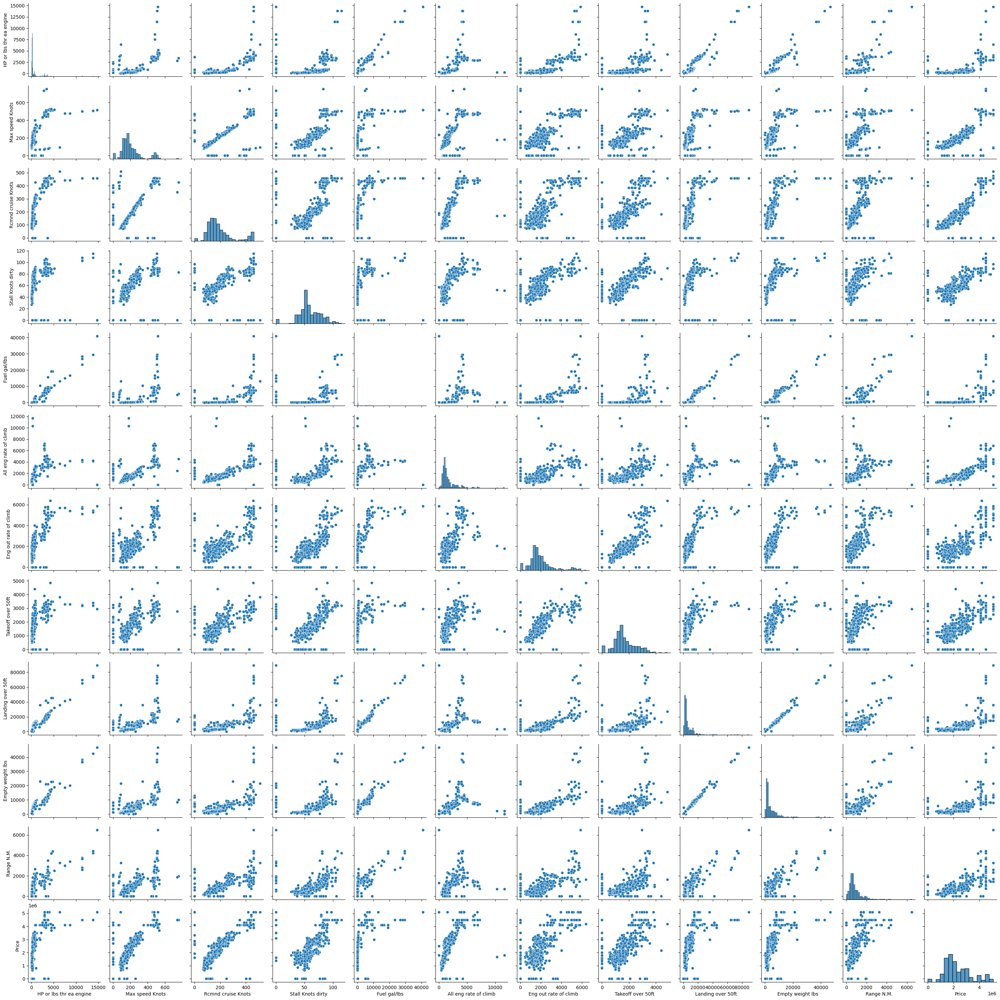

In [ ]:
sns.pairplot(df)

In [ ]:
df.corr()

<ipython-input-35-2f6f6606aa2c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,HP or lbs thr ea engine,Max speed Knots,Rcmnd cruise Knots,Stall Knots dirty,Fuel gal/lbs,All eng rate of climb,Eng out rate of climb,Takeoff over 50ft,Landing over 50ft,Empty weight lbs,Range N.M.,Price
HP or lbs thr ea engine,1.000000,0.642128,0.699614,0.339647,0.963679,0.519862,0.716621,0.556087,0.956350,0.945945,0.766392,0.630427
Max speed Knots,0.642128,1.000000,0.719501,0.498122,0.594779,0.634164,0.654996,0.615621,0.670557,0.667591,0.614052,0.769974
Rcmnd cruise Knots,0.699614,0.719501,1.000000,0.533221,0.638664,0.715568,0.718799,0.700142,0.699053,0.695134,0.665171,0.787466
Stall Knots dirty,0.339647,0.498122,0.533221,1.000000,0.290389,0.482342,0.478055,0.517988,0.408317,0.428043,0.369207,0.505759
Fuel gal/lbs,0.963679,0.594779,0.638664,0.290389,1.000000,0.431749,0.684520,0.497150,0.953530,0.939424,0.774126,0.572654
All eng rate of climb,0.519862,0.634164,0.715568,0.482342,0.431749,1.000000,0.574630,0.550029,0.490802,0.484201,0.461655,0.667007
Eng out rate of climb,0.716621,0.654996,0.718799,0.478055,0.684520,0.574630,1.000000,0.818054,0.706254,0.699833,0.652876,0.689349
Takeoff over 50ft,0.556087,0.615621,0.700142,0.517988,0.497150,0.550029,0.818054,1.000000,0.596094,0.598695,0.574846,0.673629
Landing over 50ft,0.956350,0.670557,0.699053,0.408317,0.953530,0.490802,0.706254,0.596094,1.000000,0.994641,0.804427,0.654736
Empty weight lbs,0.945945,0.667591,0.695134,0.428043,0.939424,0.484201,0.699833,0.598695,0.994641,1.000000,0.802970,0.656792


In [ ]:
new_df =(
   df
  .filter(['Model Name',
           'Engine Type',
           'HP or lbs thr ea engine',
           'Max speed Knots',
           'Rcmnd cruise Knots',
           'Stall Knots dirty',
           'Fuel gal/lbs',
           'Eng out rate of climb',
           'Empty weight lbs',
           'Length ft/in',
           'Wing span ft/in',
           'Range N.M.',
           'Price'])
  .rename(columns = {'Model Name': 'model_name',
                     'Engine Type': 'engine_type',
                     'HP or lbs thr ea engine' : 'hp_or_lbs_thr_engine',
                     'Max speed Knots': 'max_speed_knots',
                     'Rcmnd cruise Knots' : 'recommend_cruise_knots',
                     'Stall Knots dirty' : 'stall_knots_dirty',
                     'Fuel gal/lbs' : 'fuel_gal_lbs',
                     'Eng out rate of climb' : 'eng_out_rate_of_climb',
                     'Empty weight lbs' : 'empty_weight_lbs',
                     'Length ft/in' : 'length_ft_in',
                     'Wing span ft/in' : 'wing_span_ft_in',
                     'Range N.M.' : 'range_nm',
                     'Price' : 'price'

  })

)
new_df.head()

,model_name,engine_type,hp_or_lbs_thr_engine,max_speed_knots,recommend_cruise_knots,stall_knots_dirty,fuel_gal_lbs,eng_out_rate_of_climb,empty_weight_lbs,length_ft_in,wing_span_ft_in,range_nm,price
0,100 Darter (S.L. Industries),piston,145,104,91,46,36,900,1180,25/3,37/5,370,1300000
1,7 CCM Champ,piston,85,89,83,44,15,720,820,20/7,36/1,190,1230000
2,100 Darter (S.L. Industries),piston,90,90,78,37,19,475,810,21/5,35/0,210,1600000
3,7 AC Champ,piston,85,88,78,37,19,500,800,21/5,35/0,210,1300000
4,100 Darter (S.L. Industries),piston,65,83,74,33,14,632,740,21/5,35/0,175,1250000


In [ ]:
new_df.shape

(517, 13)

Deleting the rows that contains 0 in it to reduce the variance

In [ ]:
df_new=(
    new_df
   .query("price != 0")
   .query("max_speed_knots != 0")
   .query("recommend_cruise_knots != 0")
   .query("stall_knots_dirty != 0")
   .query("eng_out_rate_of_climb != 0")
   .query("empty_weight_lbs != 0")
   .query("range_nm != 0")
)

In [ ]:
df_new.head()

,model_name,engine_type,hp_or_lbs_thr_engine,max_speed_knots,recommend_cruise_knots,stall_knots_dirty,fuel_gal_lbs,eng_out_rate_of_climb,empty_weight_lbs,length_ft_in,wing_span_ft_in,range_nm,price
0,100 Darter (S.L. Industries),piston,145,104,91,46,36,900,1180,25/3,37/5,370,1300000
1,7 CCM Champ,piston,85,89,83,44,15,720,820,20/7,36/1,190,1230000
2,100 Darter (S.L. Industries),piston,90,90,78,37,19,475,810,21/5,35/0,210,1600000
3,7 AC Champ,piston,85,88,78,37,19,500,800,21/5,35/0,210,1300000
4,100 Darter (S.L. Industries),piston,65,83,74,33,14,632,740,21/5,35/0,175,1250000


In [ ]:
df_new.shape

(427, 13)

In [ ]:
# Assuming df is your DataFrame and 'length ft/in' is the column to be converted
df_new['length_numeric'] = df_new['length_ft_in'].str.split('/').apply(lambda x: int(x[0]) + int(x[1])/12)

In [ ]:
df_new['wing_span_numeric'] = df_new['wing_span_ft_in'].str.split('/').apply(lambda x: int(x[0]) + (int(x[1]) if len(x) > 1 else 0)/12)

In [ ]:
df_new = df_new.drop(columns=['wing_span_ft_in', 'length_ft_in'])

In [ ]:
df_new.head()

,model_name,engine_type,hp_or_lbs_thr_engine,max_speed_knots,recommend_cruise_knots,stall_knots_dirty,fuel_gal_lbs,eng_out_rate_of_climb,empty_weight_lbs,range_nm,price,length_numeric,wing_span_numeric
0,100 Darter (S.L. Industries),piston,145,104,91,46,36,900,1180,370,1300000,25.250000,37.416667
1,7 CCM Champ,piston,85,89,83,44,15,720,820,190,1230000,20.583333,36.083333
2,100 Darter (S.L. Industries),piston,90,90,78,37,19,475,810,210,1600000,21.416667,35.000000
3,7 AC Champ,piston,85,88,78,37,19,500,800,210,1300000,21.416667,35.000000
4,100 Darter (S.L. Industries),piston,65,83,74,33,14,632,740,175,1250000,21.416667,35.000000


In [ ]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 427 entries, 0 to 516
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   model_name              427 non-null    object 
 1   engine_type             427 non-null    object 
 2   hp_or_lbs_thr_engine    427 non-null    int64  
 3   max_speed_knots         427 non-null    int64  
 4   recommend_cruise_knots  427 non-null    int64  
 5   stall_knots_dirty       427 non-null    int64  
 6   fuel_gal_lbs            427 non-null    int64  
 7   eng_out_rate_of_climb   427 non-null    int64  
 8   empty_weight_lbs        427 non-null    int64  
 9   range_nm                427 non-null    int64  
 10  price                   427 non-null    int64  
 11  length_numeric          427 non-null    float64
 12  wing_span_numeric       427 non-null    float64
dtypes: float64(2), int64(9), object(2)
memory usage: 46.7+ KB


In [ ]:
(
    df_new
   .query("engine_type == 'jet'")

)

,model_name,engine_type,hp_or_lbs_thr_engine,max_speed_knots,recommend_cruise_knots,stall_knots_dirty,fuel_gal_lbs,eng_out_rate_of_climb,empty_weight_lbs,range_nm,price,length_numeric,wing_span_numeric
156,T 310 P turbocharged,jet,3500,491,460,99,7400,4972,9838,2289,4500000,48.666667,39.500000
157,310 Q,jet,3500,477,441,105,7431,4080,8802,2289,4500000,48.583333,39.416667
158,100 Darter (S.L. Industries),jet,3500,471,460,99,6198,4972,9838,1818,4500000,48.666667,39.500000
159,100 Darter (S.L. Industries),jet,3500,477,441,105,6171,4080,8762,1818,4500000,48.583333,39.416667
160,100 Darter (S.L. Industries),jet,2950,478,441,79,5373,2880,8157,1546,4790000,47.583333,43.750000
161,"310,-A",jet,2950,475,441,79,4704,2630,8195,1450,4880000,47.583333,43.750000
162,"T 337 G-P II,H-P, Skymaster pressurized",jet,2950,464,459,97,6098,3937,7950,1431,5100000,47.583333,35.583333
163,100 Darter (S.L. Industries),jet,2950,464,441,104,6098,5186,7355,1450,4500000,47.500000,35.583333
164,T 337 E & F Skymaster turbocharged,jet,2950,464,441,104,7464,5186,7233,1525,4500000,47.500000,35.583333
165,100 Darter (S.L. Industries),jet,2950,477,442,90,6098,5186,7206,1385,4500000,47.500000,35.500000


In [ ]:
profile_2 = ProfileReport(df_new, title="Profiling Report 2")

In [ ]:
display(profile_2)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df_new.corr()

<ipython-input-49-f2dc8e3b47bb>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df_new.corr()


,hp_or_lbs_thr_engine,max_speed_knots,recommend_cruise_knots,stall_knots_dirty,fuel_gal_lbs,eng_out_rate_of_climb,empty_weight_lbs,range_nm,price,length_numeric,wing_span_numeric
hp_or_lbs_thr_engine,1.000000,0.731224,0.733481,0.650543,0.962801,0.754658,0.955986,0.773817,0.652789,0.861719,0.695123
max_speed_knots,0.731224,1.000000,0.947647,0.850421,0.673794,0.837329,0.747702,0.775272,0.895057,0.835397,0.557490
recommend_cruise_knots,0.733481,0.947647,1.000000,0.878237,0.669403,0.851246,0.741334,0.793945,0.947477,0.847228,0.561422
stall_knots_dirty,0.650543,0.850421,0.878237,1.000000,0.573712,0.802678,0.719225,0.755967,0.850063,0.837897,0.645302
fuel_gal_lbs,0.962801,0.673794,0.669403,0.573712,1.000000,0.726411,0.947814,0.788465,0.584536,0.830300,0.703534
eng_out_rate_of_climb,0.754658,0.837329,0.851246,0.802678,0.726411,1.000000,0.766632,0.772840,0.778207,0.849657,0.605239
empty_weight_lbs,0.955986,0.747702,0.741334,0.719225,0.947814,0.766632,1.000000,0.849071,0.674764,0.924828,0.829964
range_nm,0.773817,0.775272,0.793945,0.755967,0.788465,0.772840,0.849071,1.000000,0.742729,0.866135,0.724484
price,0.652789,0.895057,0.947477,0.850063,0.584536,0.778207,0.674764,0.742729,1.000000,0.803859,0.562784
length_numeric,0.861719,0.835397,0.847228,0.837897,0.830300,0.849657,0.924828,0.866135,0.803859,1.000000,0.849556


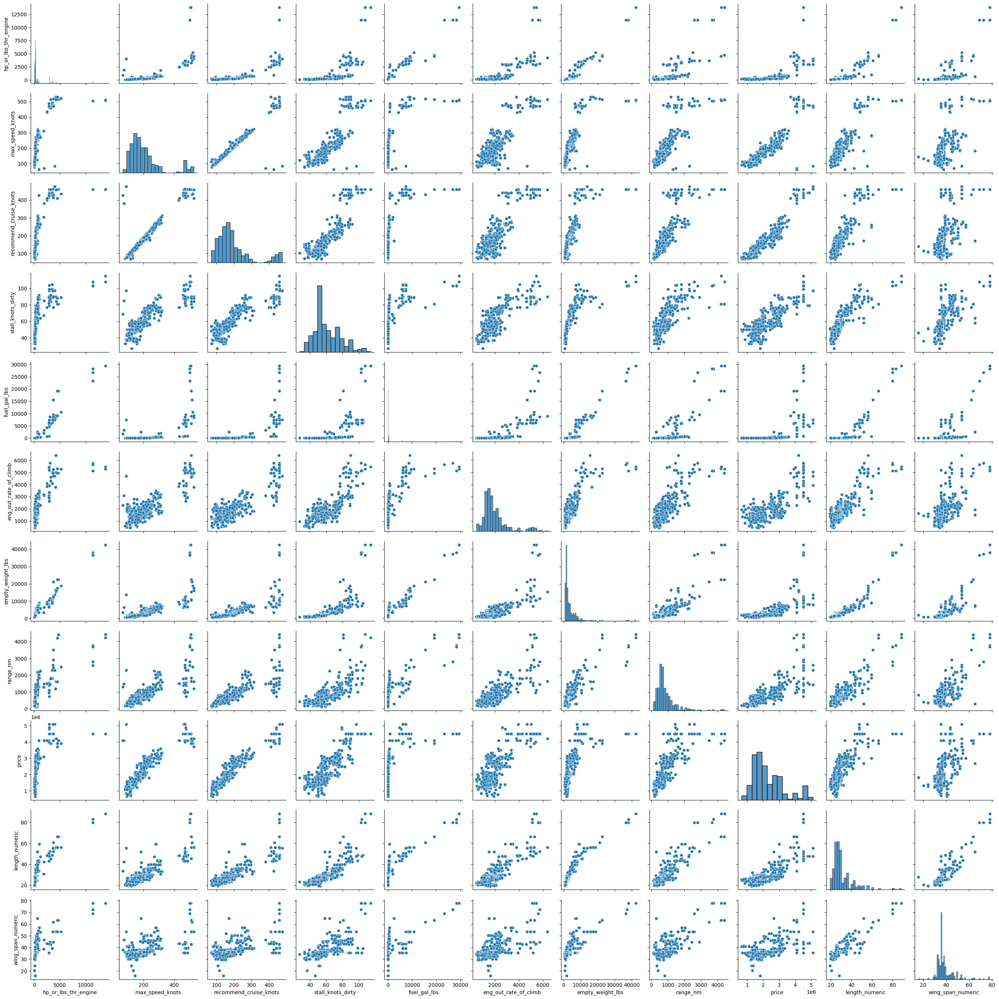

In [ ]:
sns.pairplot(df_new)

ENCODING THE COLUMNS THAT ARE OBJECTS THAT WE NEED TO MODEL WITH

In [ ]:
df_new.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 427 entries, 0 to 516
Data columns (total 13 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   model_name              427 non-null    object 
 1   engine_type             427 non-null    object 
 2   hp_or_lbs_thr_engine    427 non-null    int64  
 3   max_speed_knots         427 non-null    int64  
 4   recommend_cruise_knots  427 non-null    int64  
 5   stall_knots_dirty       427 non-null    int64  
 6   fuel_gal_lbs            427 non-null    int64  
 7   eng_out_rate_of_climb   427 non-null    int64  
 8   empty_weight_lbs        427 non-null    int64  
 9   range_nm                427 non-null    int64  
 10  price                   427 non-null    int64  
 11  length_numeric          427 non-null    float64
 12  wing_span_numeric       427 non-null    float64
dtypes: float64(2), int64(9), object(2)
memory usage: 62.9+ KB


Encoding

In [ ]:
data_new= pd.get_dummies(df_new, columns=['model_name', 'engine_type' ],drop_first=True)

In [ ]:
data_new.head()

,hp_or_lbs_thr_engine,max_speed_knots,recommend_cruise_knots,stall_knots_dirty,fuel_gal_lbs,eng_out_rate_of_climb,empty_weight_lbs,range_nm,price,length_numeric,...,model_name_Top Cub,model_name_TurboStream (Cessna 310 & 320 conv) 310hp,model_name_Twin Star Diamond DA42,model_name_U 206 A,"model_name_U206E,F, float ('75-'76 specs) '76=+4 gal fuel",model_name_V 35 TC Turbo Bonanza,model_name_V 35B Bonanza ('80 & up=fuel std 74 gal),model_name_Vision Jet SF50,engine_type_piston,engine_type_propjet
0,145,104,91,46,36,900,1180,370,1300000,25.250000,...,0,0,0,0,0,0,0,0,1,0
1,85,89,83,44,15,720,820,190,1230000,20.583333,...,0,0,0,0,0,0,0,0,1,0
2,90,90,78,37,19,475,810,210,1600000,21.416667,...,0,0,0,0,0,0,0,0,1,0
3,85,88,78,37,19,500,800,210,1300000,21.416667,...,0,0,0,0,0,0,0,0,1,0
4,65,83,74,33,14,632,740,175,1250000,21.416667,...,0,0,0,0,0,0,0,0,1,0


Data Splitting

In [ ]:
X = data_new.drop("price", axis=1)
y = data_new["price"]

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.30, random_state = 50)

Model Selection

In [ ]:
linear_reg_model = LinearRegression()

In [ ]:
linear_reg_model.fit(X_train, y_train)

LinearRegression()

In [ ]:
y_pred = linear_reg_model.predict(X_test)

In [ ]:
# Model accuracy using accuracy_score method
from sklearn import metrics
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')

Mean Squared Error: 72084073047.22423


In [ ]:
linear_reg_model.score(X_test, y_test)

0.9199888961895595

Random Forest

In [ ]:
random_forest_model = RandomForestRegressor(n_estimators=100, random_state=42)

random_forest_model.fit(X_train, y_train.ravel())

# Make predictions on the test set
y_pred_rf = random_forest_model.predict(X_test)

In [ ]:
mse_rf = mean_squared_error(y_test, y_pred_rf)
print(f'Mean Squared Error: {mse_rf}')

Mean Squared Error: 48766321293.11628


In [ ]:
random_forest_model.score(X_test, y_test)

0.9458708833936088

In [ ]:
print(len(X_test), len(y_test), len(y_pred_rf))

129 129 129


Graphical Illustration

1-  Linear Regression

In [ ]:
# Creaing a scatter plot using Plotly
fig = px.scatter(
    x=y_test,
    y=y_pred,
    labels={'x': 'Actual Price', 'y': 'Predicted Price'},
    title='Actual vs Predicted Prices',
)

fig.show()


2- Random Forest

In [ ]:
fig = px.scatter(
    x=y_test,
    y=y_pred_rf,
    labels={'x': 'Actual Price', 'y': 'Predicted Price'},
    title='Actual vs Predicted Prices',
)
fig.show()

Choosed random forest because of better performance

Feature Importance

In [ ]:
feature_importances = random_forest_model.feature_importances_
features = X.columns
indices = np.argsort(feature_importances)

In [ ]:
# Assuming 'feature_importances' and 'features' are defined from the previous code

# Sort the features based on importance
sorted_indices = np.argsort(feature_importances)

# Create a horizontal bar plot using Plotly
fig = px.bar(
    x=feature_importances[sorted_indices],
    y=[features[i] for i in sorted_indices],
    orientation='h',
    labels={'x': 'Feature Importance', 'y': 'Features'},
    title='Random Forest Feature Importance',
)
fig.show()


These are the most important features of the model that can be used in case of future predictions.